## Install Libraries

In [ ]:
!pip install powerlaw

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 192.0/192.0 kB 4.8 MB/s eta 0:00:00


In [ ]:
!pip install py3Dmol

In [ ]:
!pip install Infomap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 264.8/264.8 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for Infomap: filename=infomap-2.8.0-cp312-cp312-linux_x86_64.whl size=7716619 sha256=fe4dd857eade05d909192ee8ef6bb296840b1f434be3075c2611fa5f9b4c2b52
  Stored in directory: /root/.cache/pip/wheels/0a/d5/d5/dab47e5b039fb1997c5ca2835ee7c9a7c7e1bf2615191aebb1
Successfully built Infomap


In [ ]:
!pip install Bio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 321.3/321.3 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.7/46.7 kB 2.3 MB/s eta 0:00:00


In [ ]:
!pip install biopython propka

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.1/104.1 kB 2.1 MB/s eta 0:00:00


## Local Libraries

In [ ]:
import sys
sys.path.append('../modules')

from network_generation import *
from network_analisis import *
from structural_analisis import *

## Configuration

In [ ]:
# Configuración de estilo para las visualizaciones
plt.style.use('seaborn-v0_8-darkgrid')
matplotlib.rcParams['figure.figsize'] = [12, 8]
matplotlib.rcParams['font.size'] = 12

## Application

## ICL2 bound Acetyl-CoA II  [(6EE1)](https://www.rcsb.org/structure/6EE1)

 #### a) Uploading and network generation

In [ ]:
# Upload data GPCR-Drug complex
json_path = "../graphs/6EE1-R-Network.json"
data03 = load_ring_json_data(json_path)

File loaded successfully
Main keys: ['data', 'directed', 'multigraph', 'elements']
Directed graph: False
Multigraph: True


In [ ]:
# Extract nodes and edges
nodes_S03, edges_S03 = extract_nodes_edges(data03)
# Create DataFrames
df_nodes_S03 = pd.DataFrame(nodes_S03)
df_edges_S03 = pd.DataFrame(edges_S03)

Number of nodes extracted: 2919
Number of edges (interactions) extracted: 5382


In [ ]:
df_nodes_S03

,id,name,residue,chain,resi,resn,degree,dssp,x_coord,y_coord,z_coord
0,A/100/ILE,A/100/ILE,A/100/ILE,A,100,ILE,3,,0.212,0.576,0.392
1,A/101/GLU,A/101/GLU,A/101/GLU,A,101,GLU,5,,0.213,0.587,0.421
2,A/1021/HOH,A/1021/HOH,A/1021/HOH,A,1021,HOH,0,0.5,0.161,0.495,0.582
3,A/102/ALA,A/102/ALA,A/102/ALA,A,102,ALA,1,,0.230,0.561,0.433
4,A/103/ILE,A/103/ILE,A/103/ILE,A,103,ILE,4,E,0.252,0.536,0.427
...,...,...,...,...,...,...,...,...,...,...,...
2914,D/979/HOH,D/979/HOH,D/979/HOH,D,979,HOH,1,0.5,0.493,0.154,0.540
2915,D/97/ARG,D/97/ARG,D/97/ARG,D,97,ARG,7,H,0.657,0.404,0.546
2916,D/98/MET,D/98/MET,D/98/MET,D,98,MET,2,H,0.659,0.393,0.575
2917,D/995/HOH,D/995/HOH,D/995/HOH,D,995,HOH,0,0.5,0.512,0.164,0.543


In [ ]:
df_edges_S03

,source,target,interaction,type,distance,probability,energy
0,A/100/ILE,C/541/ARG,VDW,,2.400,1.0,0
1,A/100/ILE,A/95/MET,HBOND,,3.035,1.0,0
2,A/100/ILE,A/96/LYS,VDW,,2.697,1.0,0
3,A/101/GLU,A/70/ARG,HBOND,,2.634,1.0,0
4,A/101/GLU,A/70/ARG,HBOND,,2.742,1.0,0
...,...,...,...,...,...,...,...
5377,D/94/SER,D/97/ARG,VDW,,3.056,1.0,0
5378,D/94/SER,D/98/MET,HBOND,,2.969,1.0,0
5379,D/95/MET,D/98/MET,VDW,,2.926,1.0,0
5380,D/96/LYS,D/99/GLY,HBOND,,3.100,1.0,0


In [ ]:
# Save DataFrames
df_nodes_S03.to_csv('6EE1_protein_nodes.csv', index=False)
df_edges_S03.to_csv('6EE1_protein_interactions.csv', index=False)

In [ ]:
# Create Network
G_S03 = create_graph_from_dataframes(df_nodes_S03, df_edges_S03)

In [ ]:
G_S03

**Basic descriptors**

In [ ]:
print("\n=== GRAPH INFORMATION ===")
print(f"Number of nodes: {G_S03.number_of_nodes()}")
print(f"Number of edges: {G_S03.number_of_edges()}")
print(f"Graph density: {nx.density(G_S03):.4f}")
print(f"Is the graph connected? {nx.is_connected(G_S03)}")

# Additional information about nodes
if G_S03.number_of_nodes() > 0:
    first_node = list(G_S03.nodes(data=True))[0]
    print(f"\nNode example: {first_node[0]}")
    print(f"Node attributes: {first_node[1]}")


=== GRAPH INFORMATION ===
Number of nodes: 2919
Number of edges: 3849
Graph density: 0.0009
Is the graph connected? False

Node example: A/100/ILE
Node attributes: {'residue': 'A/100/ILE', 'chain': 'A', 'resi': 100, 'resn': 'ILE', 'degree': 3, 'dssp': ' ', 'x_coord': 0.212, 'y_coord': 0.576, 'z_coord': 0.392}


### Analisis

#### **a) Clustering: average clustering coefficient.**

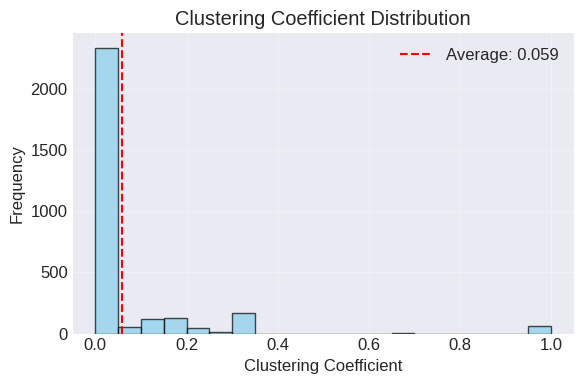

Average Clustering Coefficient: 0.0588
Number of nodes: 2919
Number of edges: 3849


In [ ]:
df_Clustering_coefficient_G_S03=analyze_clustering(G_S03)

#### **b) Distances: average shortest–path length and (effective) diameter.**

Graph not connected. Using giant component...
Nodes in giant component: 2625
Calculating distances... (may take time for large graphs)


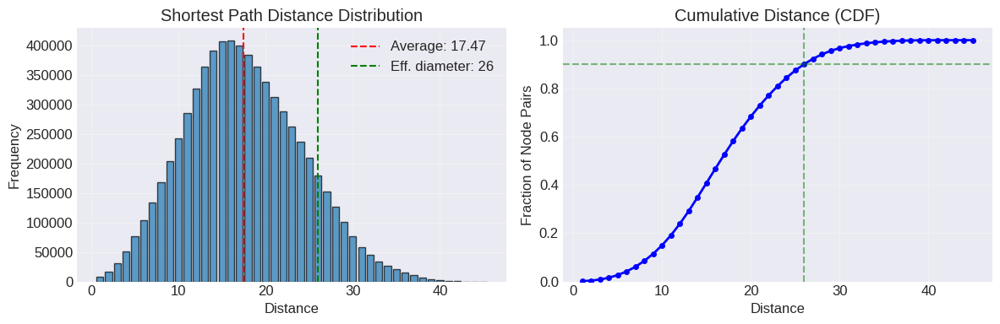


=== DISTANCE RESULTS ===
Average path length: 17.4669
Diameter (maximum distance): 45
Effective diameter (90%): 26
Number of node pairs: 6888000
Most common distance: 16 (appears 409562 times)


In [ ]:
dict_Distances_G_S03=analyze_distances(G_S03)

#### **c) Degree statistics:**

**Degree distribution**

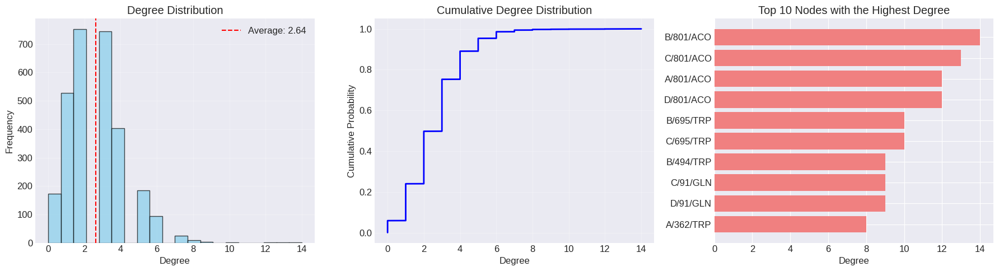


=== DEGREE STATISTICS===
Average degree: 2.64
Highest degree: 14
Minimum degree: 0
Standard deviation: 1.57

Top 10 residues with a higher average grade:
  ACO: 12.75
  TRP: 6.32
  TYR: 3.85
  PHE: 3.68
  ARG: 3.46
  MET: 3.32
  HIS: 3.14
  GLN: 3.08
  ASN: 3.00
  ILE: 2.77


In [ ]:
# Generar gráficos de distribución de grado
degrees_S03 = plot_distribucion_grado(G_S03)

**Degree statistics: Network topology analysis**

/usr/local/lib/python3.12/dist-packages/powerlaw/fitting.py:264: UserWarning:

Values less than or equal to 0 in data. Throwing out 0 or negative values.



Calculating best minimal value for power law fit


Fitting xmin: 100%|██████████| 11/11 [00:00<00:00, 177.05it/s]
/usr/local/lib/python3.12/dist-packages/powerlaw/distributions.py:743: OptimizeWarning:

Initial guess is not within the specified bounds



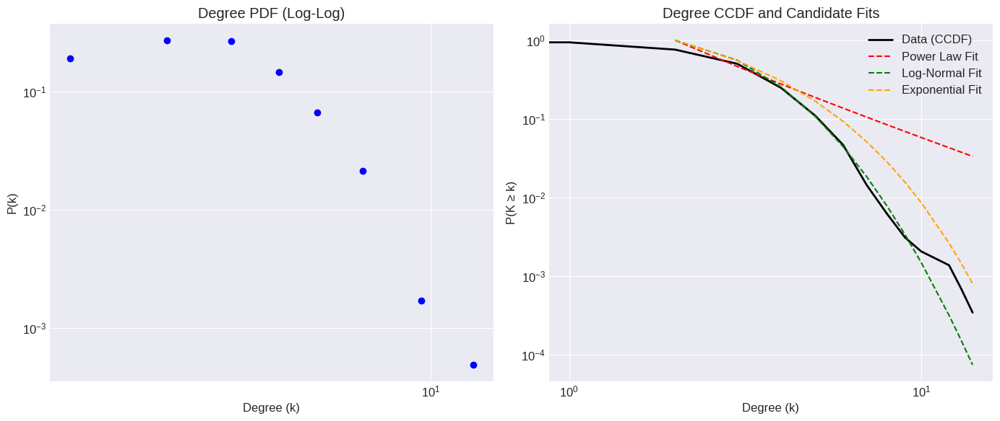

Estimated Alpha value (Power Law): 2.58
xmin value (tail start): 2.0

Power Law vs Exponential comparison: R=-329.65, p-value=0.0000
Power Law vs Log-Normal comparison: R=-434.95, p-value=0.0000


In [ ]:
analyze_degree_statistics(G_S03)

**Discussion**

- **$α=2.61$:** This value falls within the typical range for "small-world" networks (usually between 2<α<3) but the likelihood ratio tests indicate otherwise. Then, this number is only an estimate of the slope in a specific segment, but does not define the overall nature of the network.
- **Negative R (R<0):** In both the comparison with the Exponential (R=−342.53) and Log-Normal (R=−458.48) models, the negative sign indicates that the second model is much better than Power Law at explaining the data.
- **Statistical Significance (p=0.0000):** Because it is less than 0.05, with complete certainty these results are not due to chance.

After performing a goodness-of-fit analysis using the Likelihood Ratio Test, the hypothesis of a Power Law distribution was rejected (p<0.05). The data show a statistically significant preference for a Log-Normal distribution (R=−458.48), suggesting that the network does not have a scale-free architecture, but rather exhibits saturation in the connectivity of the most important nodes. In terms of protein physics, the coexistence of a Log-Normal degree distribution with Small-world properties reveals how evolution has optimized the protein structure to be efficient:
- **Log-Normal distribution**:  The fact that the likelihood ratio (R) test favors the Log-Normal distribution over the Power Law distribution is due to spatial and volume exclusion constraints (Steric Saturation). In a social network, a "hub" can have infinite connections but in a protein, a residue has a limited physical space around it. Fifty residues cannot fit in direct contact with a single residue. This creates a "saturation point" that cuts off the tail of the distribution (typical of a Log-Normal distribution).
- **Small-world propertie**: The value of α=2.61 is in the range typically associated with scale-free networks (2-3), but even if the network is not purely scale-free (as the R value proved), this exponent reflects a Small-World topology:
    * **Structural Shortcuts (Long-range contacts):** Protein folding brings together residues that are far apart in the primary sequence (in the linear chain). These long-range contacts act as "bridges" or shortcuts.
    * **High Connectivity of Critical Nodes:** Although there are not "super-hubs" of 500 edges, there are residues with above-average connectivity (residues in the hydrophobic core). A value of α of 2.61 indicates that there are enough nodes with moderately high connectivity to keep the entire protein connected with very few steps (an average of 3 to 5 jumps between any pair of residues). The protein needs to transmit allosteric signals (information) rapidly from one end to the other for its catalytic or binding function. Therefore, it maintains a low α value, which ensures that the shortest path between residues is short.



#### **d) Centrality structure:**

**Centrality_distribution**


=== CENTRALITY ANALYSIS ===
Calculating betweenness centrality...
Calculating closeness centrality...
Calculating degree centrality...
Calculating eigenvector centrality...


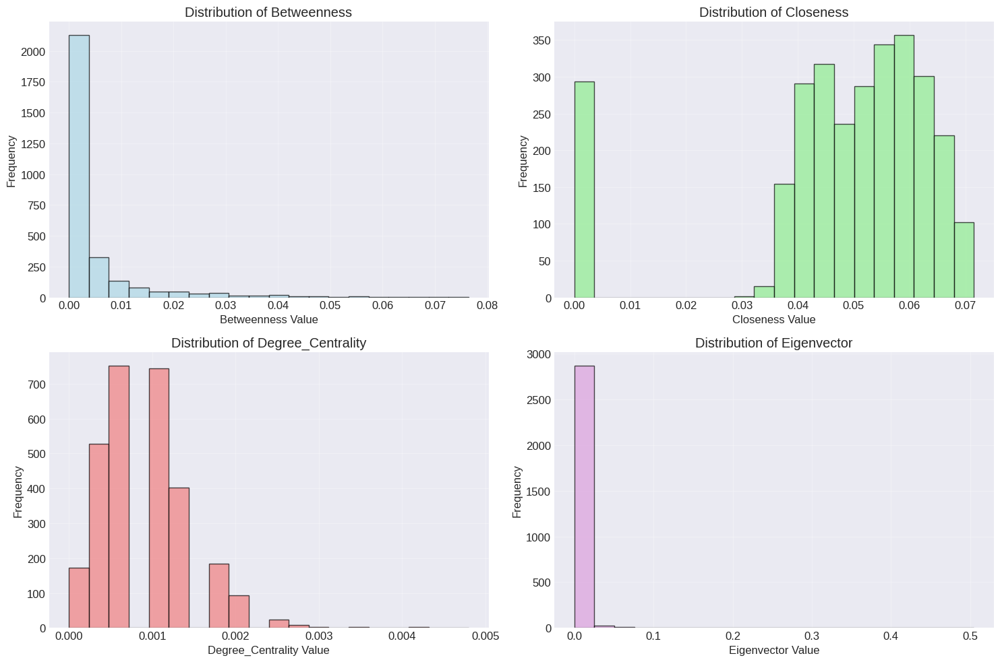


=== TOP NODES BY CENTRALITY ===

Top 5 by Betweenness:
     Node   Residue  Betweenness
C/108/TRP C/108/TRP     0.076425
D/457/TRP D/457/TRP     0.073372
B/559/GLU B/559/GLU     0.072098
B/608/ARG B/608/ARG     0.071666
A/559/GLU A/559/GLU     0.067874

Top 5 by Closeness:
     Node   Residue  Closeness
D/135/ASP D/135/ASP   0.071536
B/115/SER B/115/SER   0.071251
B/135/ASP B/135/ASP   0.071251
B/131/GLN B/131/GLN   0.071210
B/195/PHE B/195/PHE   0.071062

Top 5 by Degree_Centrality:
     Node   Residue  Degree_Centrality
B/801/ACO B/801/ACO           0.004798
C/801/ACO C/801/ACO           0.004455
A/801/ACO A/801/ACO           0.004112
D/801/ACO D/801/ACO           0.004112
B/695/TRP B/695/TRP           0.003427

Top 5 by Eigenvector:
     Node   Residue  Eigenvector
D/801/ACO D/801/ACO     0.504740
D/687/ARG D/687/ARG     0.376391
D/764/LYS D/764/LYS     0.313602
D/724/HIS D/724/HIS     0.252102
D/720/LYS D/720/LYS     0.208191


In [ ]:
# Realizar análisis de centralidad
centralidad_df_S03 = analyze_centrality(G_S03)

**Centrality structure: Rank the top 50 nodes**

In [ ]:
def analyze_centrality_rankings(G, top_n=50):
    print("Calculating centrality metrics... this may take a moment.")

    # 1. Centrality Calculations
    dict_centralities = {
        'Degree': nx.degree_centrality(G),
        'Closeness': nx.closeness_centrality(G),
        'Betweenness': nx.betweenness_centrality(G),
        'Eigenvector': nx.eigenvector_centrality(G, max_iter=1000),
        'Katz': nx.katz_centrality(G, alpha=0.1, beta=1.0),
        'PageRank': nx.pagerank(G),
        'Subgraph': nx.subgraph_centrality(G)
    }

    # 2. Create DataFrame to compare rankings - CORRECCIÓN AQUÍ
    # Primero creamos un DataFrame con los nodos como columna
    df_ranks = pd.DataFrame({
        'Node': list(G.nodes())
    })

    # Luego agregamos las métricas de centralidad
    for name, values in dict_centralities.items():
        # Crear Series con los valores para cada nodo
        value_series = pd.Series(values)

        # Añadir valores
        df_ranks[f'{name}_Val'] = df_ranks['Node'].map(value_series)

        # Crear ranking (1 = most central)
        df_ranks[f'{name}_Rank'] = df_ranks[f'{name}_Val'].rank(ascending=False, method='min')

    # 3. Get Top N for each metric
    top_nodes_dict = {}
    for name in dict_centralities.keys():
        top_list = df_ranks.sort_values(by=f'{name}_Val', ascending=False).head(top_n)['Node'].tolist()
        top_nodes_dict[name] = top_list

    df_top_n = pd.DataFrame(top_nodes_dict)

    # 4. Export results
    df_top_n.to_csv(f"top_{top_n}_centralities.csv", index=False)
    print(f"Top {top_n} saved to 'top_{top_n}_centralities.csv'")

    # También exportar el DataFrame completo con todos los datos
    df_ranks.to_csv("all_centrality_data.csv", index=False)
    print("All centrality data saved to 'all_centrality_data.csv'")

    return df_ranks, df_top_n

# Execution
# df_full, df_top50 = analyze_centrality_rankings(G)

In [ ]:
df_full_G_S03, df_top50_G_S03 = analyze_centrality_rankings(G_S03)

Calculating centrality metrics... this may take a moment.
Top 50 saved to 'top_50_centralities.csv'


In [ ]:
# Guardar DataFrame como CSV
df_full_G_S03.to_csv('G_S03_full_centrality.csv', index=False)

In [ ]:
# Open CSV as DataFrame
df_full_G_S03 = pd.read_csv('G_S03_full_centrality.csv')

In [ ]:
df_full_G_S03

,Degree_Val,Degree_Rank,Closeness_Val,Closeness_Rank,Betweenness_Val,Betweenness_Rank,Eigenvector_Val,Eigenvector_Rank,Katz_Val,Katz_Rank,PageRank_Val,PageRank_Rank,Subgraph_Val,Subgraph_Rank
A/100/ILE,0.001028,724.0,0.059638,743.0,0.000509,1819.0,1.014795e-08,1513.0,0.018995,1016.0,0.000361,1193.0,3.725221,984.0
A/101/GLU,0.000343,2220.0,0.044955,1980.0,0.000000,2159.0,4.548895e-12,2508.0,0.014841,2370.0,0.000184,2452.0,1.704293,2344.0
A/1021/HOH,0.000000,2748.0,0.000000,2748.0,0.000000,2159.0,0.000000e+00,2655.0,0.012862,2748.0,0.000054,2748.0,1.000000,2753.0
A/102/ALA,0.000343,2220.0,0.057942,905.0,0.000000,2159.0,7.114903e-10,2006.0,0.014730,2407.0,0.000164,2634.0,1.650320,2422.0
A/103/ILE,0.001371,321.0,0.065483,248.0,0.013837,270.0,1.271445e-08,1458.0,0.021146,512.0,0.000440,654.0,4.632586,626.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D/979/HOH,0.000343,2220.0,0.000343,2688.0,0.000000,2159.0,0.000000e+00,2655.0,0.014291,2688.0,0.000361,1195.0,1.543081,2719.0
D/97/ARG,0.001028,724.0,0.064038,351.0,0.004014,776.0,1.629912e-05,469.0,0.019434,857.0,0.000352,1340.0,3.619693,1042.0
D/98/MET,0.000685,1468.0,0.060980,614.0,0.000001,2122.0,7.777378e-06,546.0,0.017144,1620.0,0.000252,2141.0,2.697171,1604.0
D/995/HOH,0.000000,2748.0,0.000000,2748.0,0.000000,2159.0,0.000000e+00,2655.0,0.012862,2748.0,0.000054,2748.0,1.000000,2770.0


In [ ]:
df_full_G_S03F = df_full_G_S03.reset_index().rename(columns={'index': 'Node'})

In [ ]:
df_full_G_S03F

,Node,Degree_Val,Degree_Rank,Closeness_Val,Closeness_Rank,Betweenness_Val,Betweenness_Rank,Eigenvector_Val,Eigenvector_Rank,Katz_Val,Katz_Rank,PageRank_Val,PageRank_Rank,Subgraph_Val,Subgraph_Rank
0,A/100/ILE,0.001028,724.0,0.059638,743.0,0.000509,1819.0,1.014795e-08,1513.0,0.018995,1016.0,0.000361,1193.0,3.725221,984.0
1,A/101/GLU,0.000343,2220.0,0.044955,1980.0,0.000000,2159.0,4.548895e-12,2508.0,0.014841,2370.0,0.000184,2452.0,1.704293,2344.0
2,A/1021/HOH,0.000000,2748.0,0.000000,2748.0,0.000000,2159.0,0.000000e+00,2655.0,0.012862,2748.0,0.000054,2748.0,1.000000,2753.0
3,A/102/ALA,0.000343,2220.0,0.057942,905.0,0.000000,2159.0,7.114903e-10,2006.0,0.014730,2407.0,0.000164,2634.0,1.650320,2422.0
4,A/103/ILE,0.001371,321.0,0.065483,248.0,0.013837,270.0,1.271445e-08,1458.0,0.021146,512.0,0.000440,654.0,4.632586,626.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2914,D/979/HOH,0.000343,2220.0,0.000343,2688.0,0.000000,2159.0,0.000000e+00,2655.0,0.014291,2688.0,0.000361,1195.0,1.543081,2719.0
2915,D/97/ARG,0.001028,724.0,0.064038,351.0,0.004014,776.0,1.629912e-05,469.0,0.019434,857.0,0.000352,1340.0,3.619693,1042.0
2916,D/98/MET,0.000685,1468.0,0.060980,614.0,0.000001,2122.0,7.777378e-06,546.0,0.017144,1620.0,0.000252,2141.0,2.697171,1604.0
2917,D/995/HOH,0.000000,2748.0,0.000000,2748.0,0.000000,2159.0,0.000000e+00,2655.0,0.012862,2748.0,0.000054,2748.0,1.000000,2770.0


In [ ]:
# Guardar DataFrame como CSV
df_top50_G_S03.to_csv('G_S03_top50_centrality.csv', index=False)

In [ ]:
# Open CSV as DataFrame
df_top50_G_S03 = pd.read_csv('G_S03_top50_centrality.csv')

In [ ]:
df_top50_G_S03

,Degree,Closeness,Betweenness,Eigenvector,Katz,PageRank,Subgraph
0,B/801/ACO,D/135/ASP,C/108/TRP,D/801/ACO,B/801/ACO,B/801/ACO,B/801/ACO
1,C/801/ACO,B/115/SER,D/457/TRP,D/687/ARG,C/801/ACO,C/801/ACO,A/801/ACO
2,D/801/ACO,B/135/ASP,B/559/GLU,D/764/LYS,A/801/ACO,D/801/ACO,D/801/ACO
3,A/801/ACO,B/131/GLN,B/608/ARG,D/724/HIS,D/801/ACO,A/801/ACO,C/801/ACO
4,C/695/TRP,B/195/PHE,A/559/GLU,D/720/LYS,C/695/TRP,C/695/TRP,B/494/TRP
5,B/695/TRP,D/195/PHE,C/527/GLN,D/690/THR,B/695/TRP,B/695/TRP,B/695/TRP
6,B/494/TRP,D/198/VAL,A/608/ARG,D/761/LEU,D/91/GLN,D/96/LYS,D/687/ARG
7,D/91/GLN,D/115/SER,A/555/MET,D/685/GLN,B/494/TRP,C/396/TRP,C/695/TRP
8,C/91/GLN,D/138/VAL,C/559/GLU,D/716/TYR,C/91/GLN,A/396/TRP,C/91/GLN
9,C/494/TRP,D/194/ARG,C/608/ARG,B/801/ACO,D/687/ARG,D/91/GLN,D/91/GLN


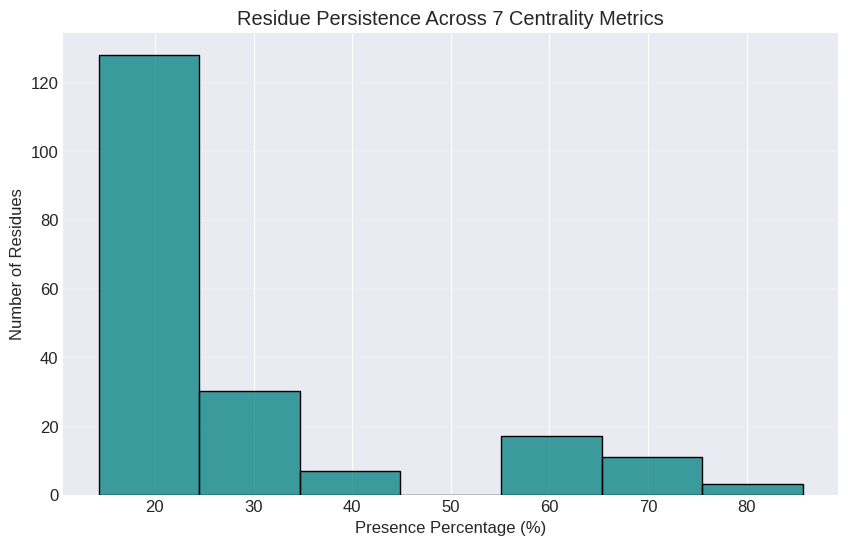

In [ ]:
df_persistencedf_top50_G_S03 = analyze_top_residues_consensus(df_top50_G_S03)

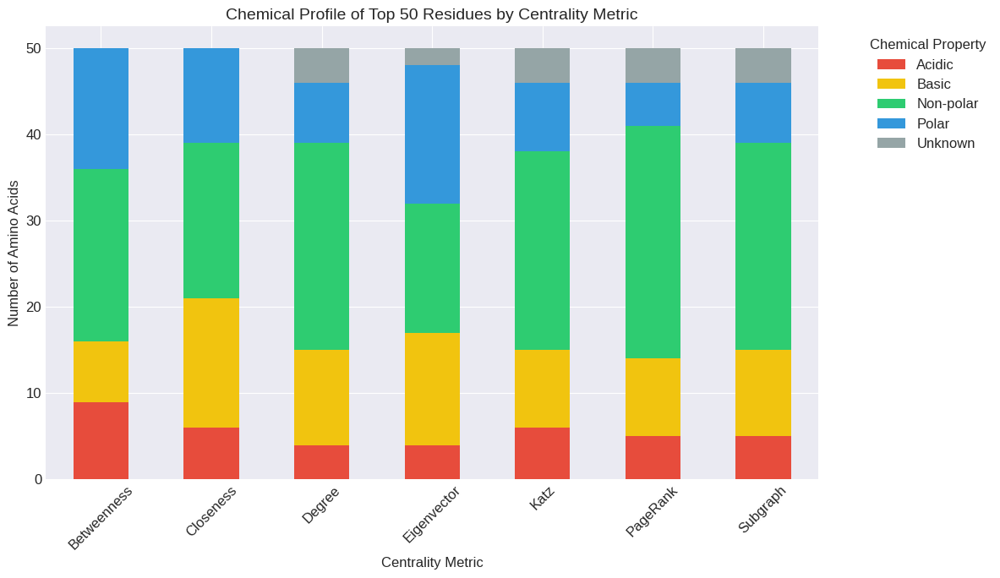

In [ ]:
df_chemical_count_G_S03 = plot_physicochemical_centrality_comparison(df_top50_G_S03)

/tmp/ipython-input-2046957629.py:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




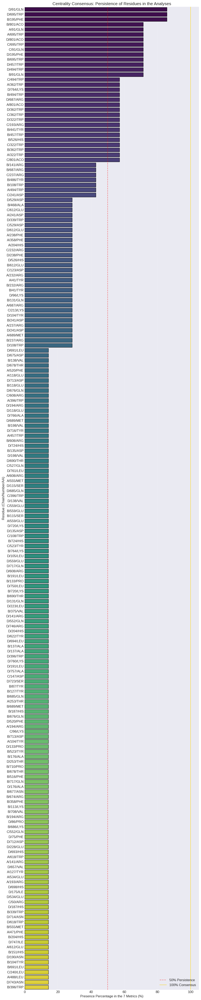

In [ ]:
df_key_residues_G_S03 = generate_complete_persistence_analysis(df_top50_G_S03)

In [ ]:
#visualize_persistence_3d(df_key_residues_G_S01, pdb_path='./6EE1-R.pdb')
visualize_persistence_3d_clean(df_key_residues_G_S03, pdb_path='../structures/6EE1-R.pdb')

✅ Visualizing ./6EE1-R.pdb. Labels only shown for the 10 most persistent residues.


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
visualize_3d_persistence_pro(df_key_residues_G_S03, pdb_path='../structures/6EE1-R.pdb', show_labels=False)

🔹 Showing ./6EE1-R.pdb without labels (clean view)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
nearby_residues_MG802 = find_nearby_amino_acids('../structures/6EE1-R.pdb', target_residue="MG", residue_number=802, distance=4.0)
df_nearby_MG802 = pd.DataFrame(nearby_residues_MG802)
df_nearby_MG802

,chain,residue,number,distance
0,A,ILE,37,3.922340
1,A,ALA,450,2.265386
2,A,ALA,453,2.439789
3,A,GLN,482,2.306984
4,B,ILE,37,3.980850
5,B,ALA,450,2.229146
6,B,ALA,453,2.411570
7,B,GLN,482,2.249857
8,C,ALA,450,2.177706
9,C,ALA,453,2.454307


#### d) Null models

Null models: generate ten Erdős–Rényi (ER) and ten Barabási–Albert (BA) networks with the same number of nodes and edges as your real network.

In [ ]:
df_nulls_G_S03 = null_models_analysis(G_S03)
df_nulls_G_S03

,Metric,Real,ER_Mean,ER_Std,BA_Mean,BA_Std
Alpha,Alpha,2.577759,2.528335,1.470857e-02,2.563909,1.727011e-01
Avg_Betweenness,Avg_Betweenness,0.004565,0.001979,3.518484e-05,0.002527,1.386461e-04
Avg_Closeness,Avg_Closeness,0.047782,0.103910,8.022046e-04,0.123961,6.082218e-03
Avg_Eigenvector,Avg_Eigenvector,0.002166,0.010797,1.097831e-03,0.003950,3.449030e-04
Avg_PageRank,Avg_PageRank,0.000343,0.000343,5.993153e-20,0.000343,7.666467e-20


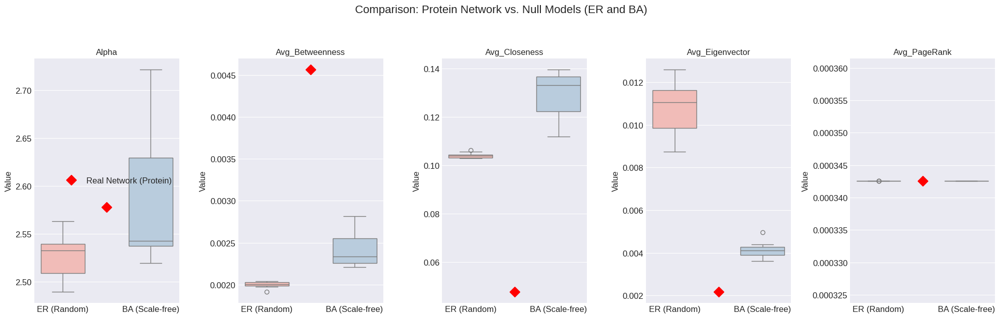

In [ ]:
plot_null_model_comparison(G_S03)

#### f) Community analysis

**Infomap Community analysis**

/tmp/ipython-input-3546655207.py:20: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



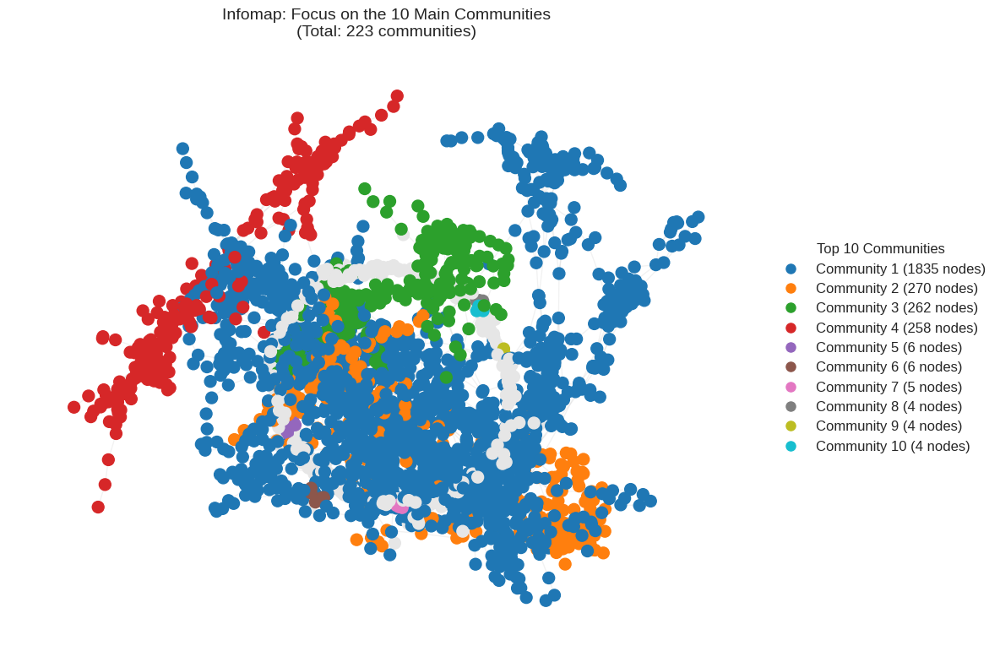

In [ ]:
result_S03 = analyze_and_visualize_infomap(G_S03)

**Comparative Community analysis**

/tmp/ipython-input-3416029263.py:61: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



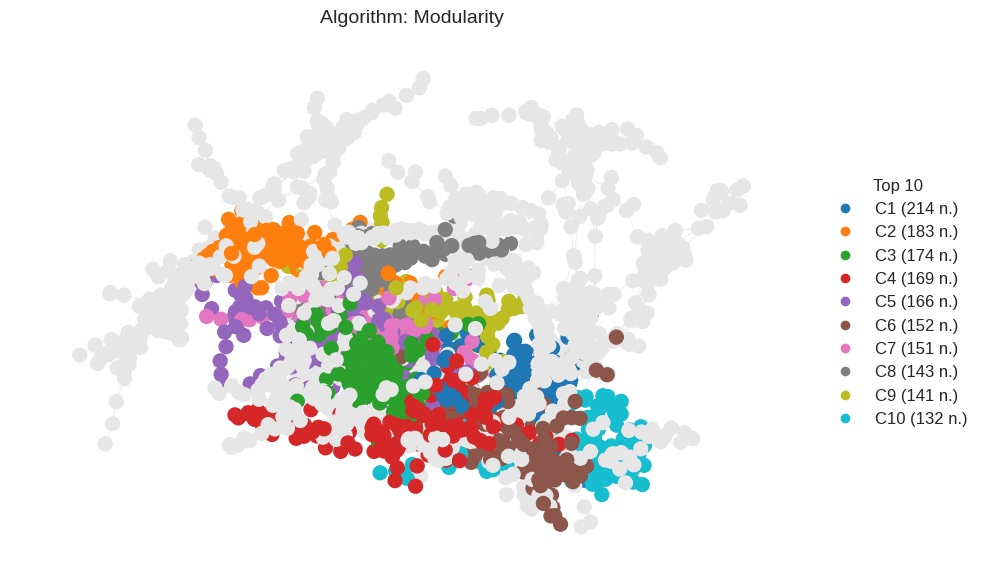

/tmp/ipython-input-3416029263.py:61: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



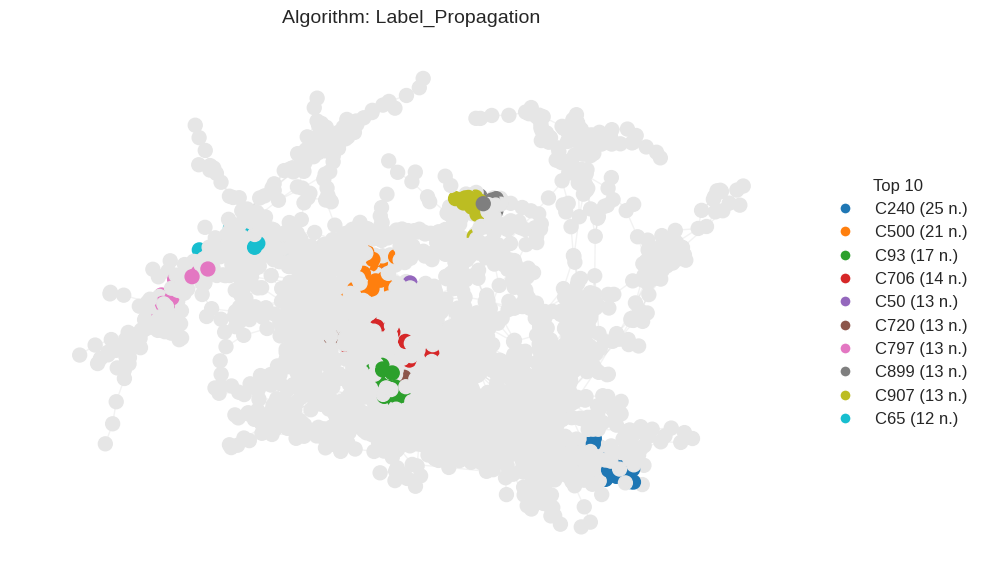

/tmp/ipython-input-3416029263.py:61: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



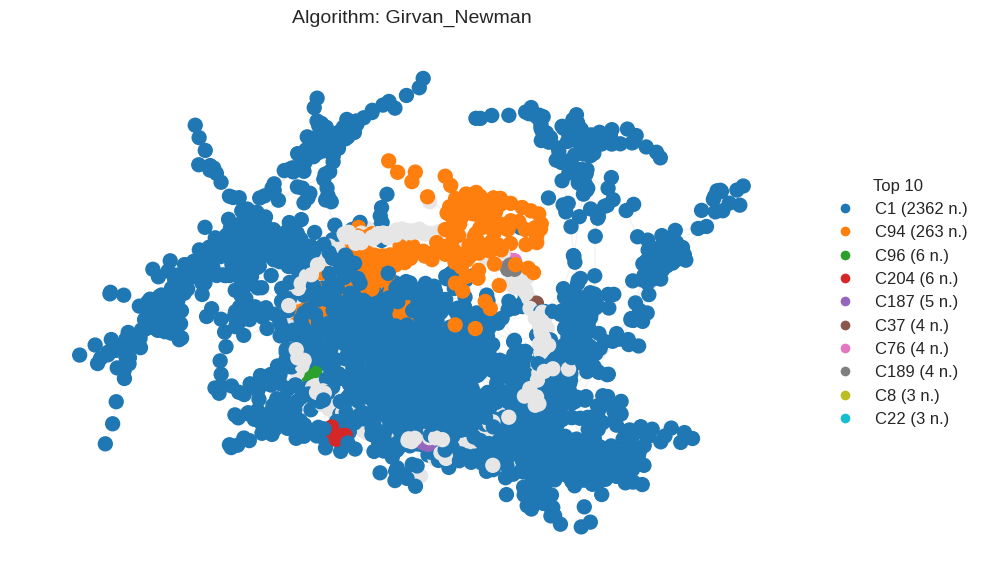

/tmp/ipython-input-3416029263.py:61: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



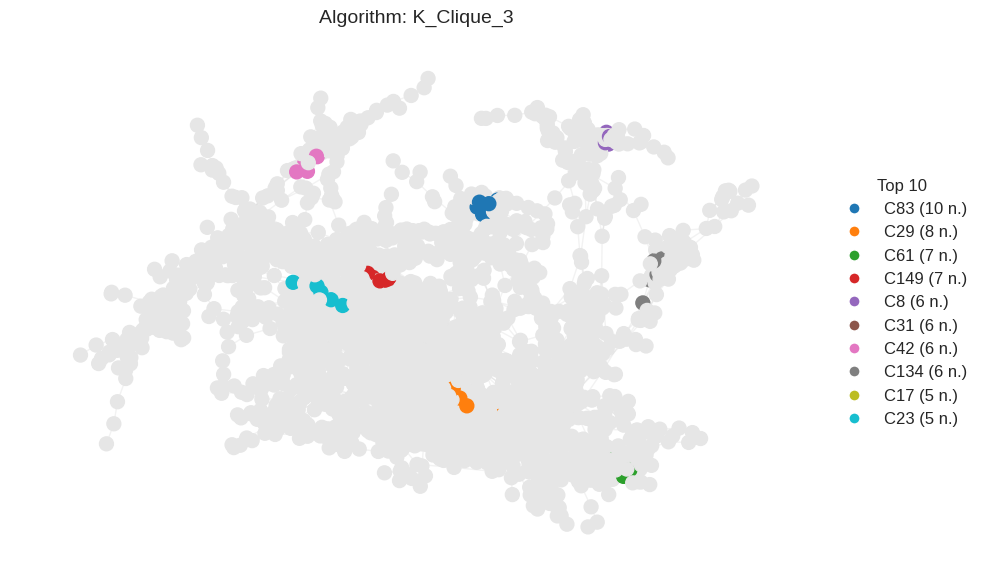

✅ Analysis complete. File saved as: G_S03_mi_analisis_completo.csv


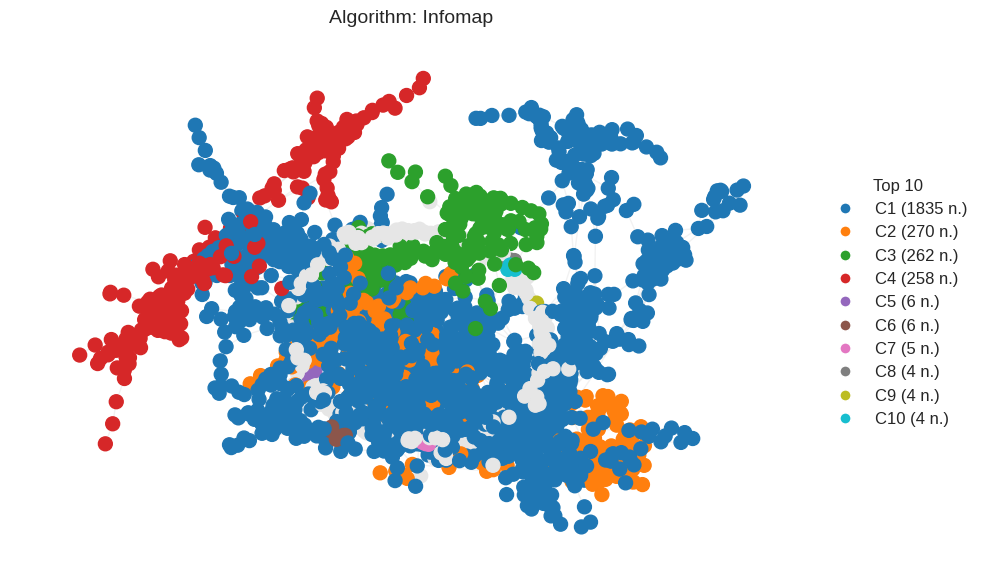

In [ ]:
df_resultados_Community_analysis_G_S03 = comparative_community_analysis(G_S03, "G_S03_mi_analisis_completo.csv")

In [ ]:
# Reading the generated Community Data
nombre_archivo_G_S03 = "G_S03_mi_analisis_completo.csv"
df_community_analisis_G_S03 = pd.read_csv(nombre_archivo_G_S03)
df_community_analisis_G_S03

,Node,Infomap,Modularity,Label_Propagation,Girvan_Newman,K_Clique_3
0,A/100/ILE,1,7,1,1,0
1,A/101/GLU,1,24,2,1,0
2,A/1021/HOH,153,73,3,2,0
3,A/102/ALA,1,9,4,1,0
4,A/103/ILE,1,9,5,1,0
...,...,...,...,...,...,...
2914,D/979/HOH,32,72,822,188,0
2915,D/97/ARG,1,4,930,1,0
2916,D/98/MET,1,4,433,1,0
2917,D/995/HOH,103,244,931,221,0


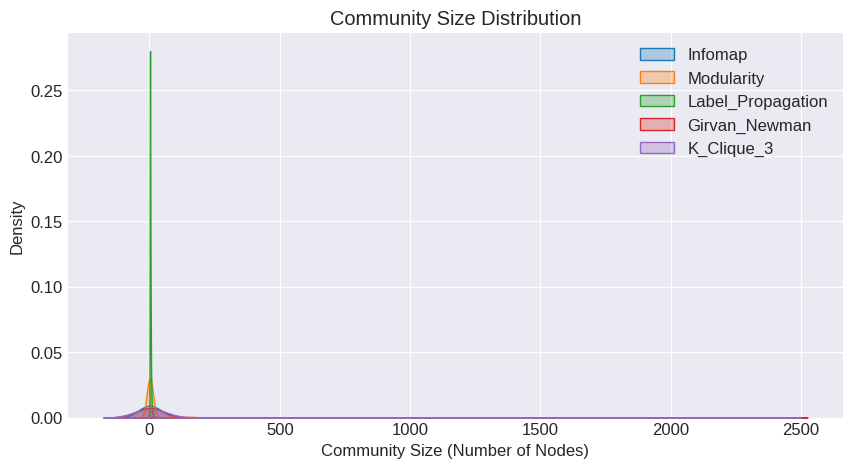

In [ ]:
# Definir los métodos que estás analizando
metodos = ['Infomap', 'Modularity', 'Label_Propagation', 'Girvan_Newman', 'K_Clique_3']

# Count community sizes by method and graph them
plt.figure(figsize=(10, 5))
for metodo in metodos:
    counts_G_S03 = df_community_analisis_G_S03[metodo].value_counts().values
    sns.kdeplot(counts_G_S03, label=metodo, fill=True, alpha=0.3)

plt.xlabel("Community Size (Number of Nodes)")
plt.ylabel("Density")
plt.title("Community Size Distribution")
plt.legend()
plt.show()

**Consensus analysis between community analysis algorithms**

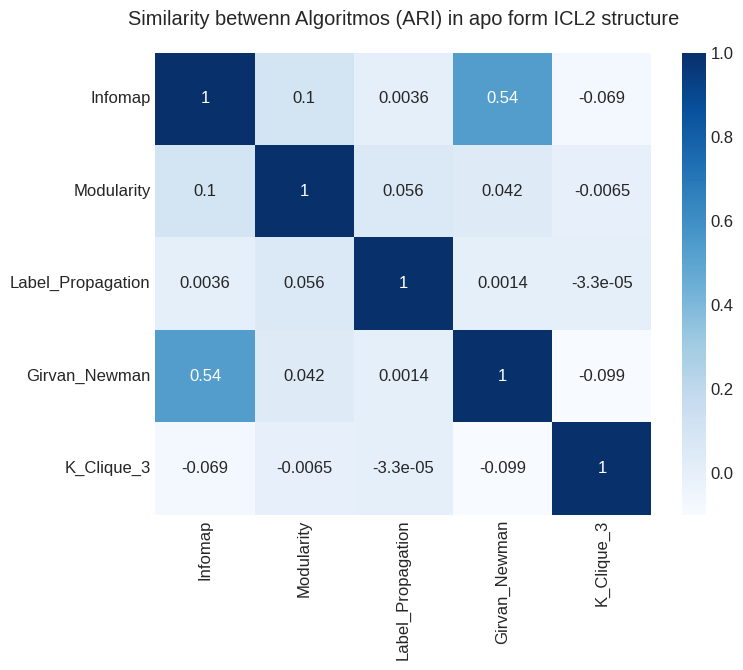

In [ ]:
from sklearn.metrics import adjusted_rand_score
import seaborn as sns

# Calculate similarity matrix between columns
metodos = df_community_analisis_G_S03.columns[1:] # Excluimos la columna 'Nodo'
ari_matrix_G_S03 = pd.DataFrame(index=metodos, columns=metodos)

for m1 in metodos:
    for m2 in metodos:
        ari_matrix_G_S03.loc[m1, m2] = adjusted_rand_score(df_community_analisis_G_S03[m1], df_community_analisis_G_S03[m2])

plt.figure(figsize=(8, 6))
sns.heatmap(ari_matrix_G_S03.astype(float), annot=True, cmap='Blues')
plt.title("Similarity betwenn Algoritmos (ARI) in apo form ICL2 structure",
          pad=20)
plt.show()

In [ ]:
visualize_local_pdb_communities(df_community_analisis_G_S03, 'Infomap', '../structures/6EE1-R.pdb', n_communities=4)

📊 Coloring the 4 largest communities for method: Infomap
   - Community 1: #1f77b4 (1835 residues)
   - Community 2: #ff7f0e (270 residues)
   - Community 3: #2ca02c (262 residues)
   - Community 4: #d62728 (258 residues)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
visualize_local_pdb_communities(df_community_analisis_G_S03, 'Girvan_Newman', '../structures/6EE1-R.pdb', n_communities=4)

📊 Coloring the 4 largest communities for method: Girvan_Newman
   - Community 1: #1f77b4 (2362 residues)
   - Community 94: #ff7f0e (263 residues)
   - Community 96: #2ca02c (6 residues)
   - Community 204: #d62728 (6 residues)


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

**Which nodes are most related?**

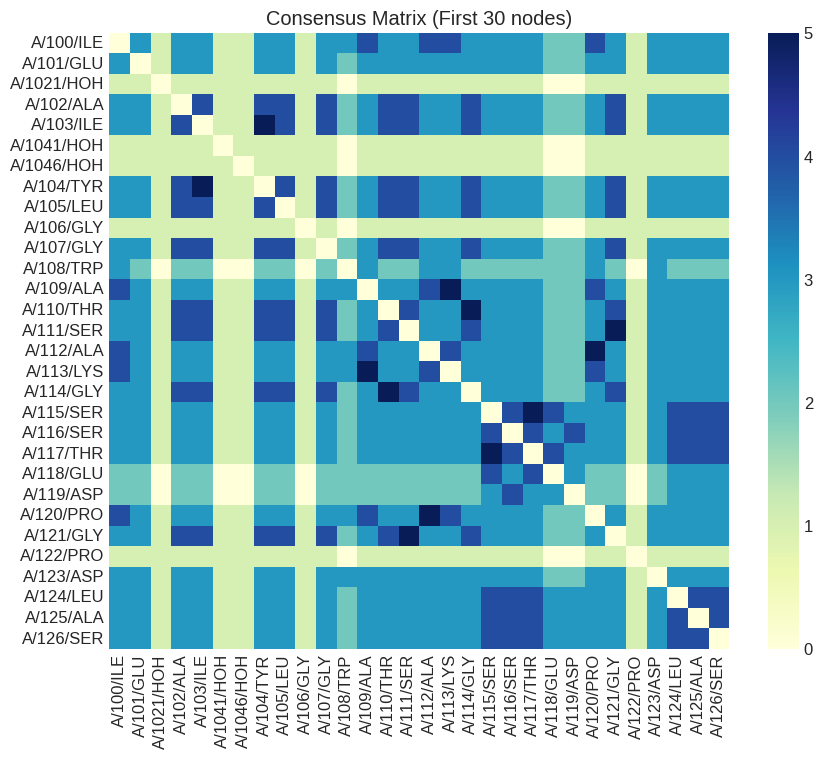

In [ ]:
nodos = df_community_analisis_G_S03['Node'].values
n = len(nodos)
co_occurrence = np.zeros((n, n))

# Iterate through each pair of nodes
for i in range(n):
    for j in range(i + 1, n):
        # Count how many columns have the same values ​​in row i and j
        matches = (df_community_analisis_G_S03.iloc[i, 1:] == df_community_analisis_G_S03.iloc[j, 1:]).sum()
        co_occurrence[i, j] = co_occurrence[j, i] = matches

# Visualize a sample or the nodes with the highest relationship
plt.figure(figsize=(10, 8))
sns.heatmap(co_occurrence[:30, :30], xticklabels=nodos[:30], yticklabels=nodos[:30], cmap="YlGnBu")
plt.title("Consensus Matrix (First 30 nodes)")
plt.show()

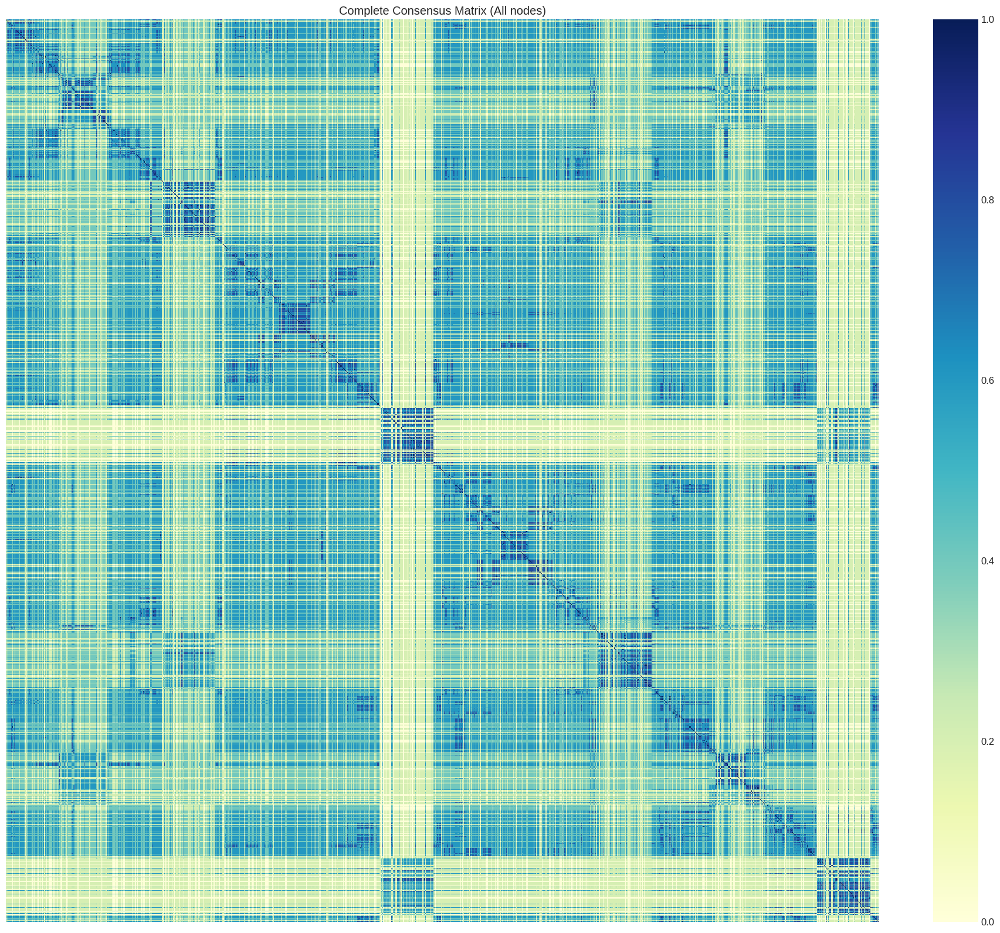

In [ ]:
# Consensus Matrix
matriz_total_G_S03 = generate_consensus_matrix(df_community_analisis_G_S03)

# Visualización (si n_nodos es manejable, ej. < 200)
plt.figure(figsize=(24, 20))
sns.heatmap(matriz_total_G_S03, cmap="YlGnBu", xticklabels=False, yticklabels=False)
plt.title("Complete Consensus Matrix (All nodes)")
plt.savefig("G_S03_Consensus Matrix.png", dpi=300, bbox_inches='tight')
plt.savefig("G_S03_Consensus Matrix.pdf", bbox_inches='tight')
plt.savefig("G_S03_Consensus Matrix.svg", bbox_inches='tight')
plt.show()

**Generate Consensus graph**

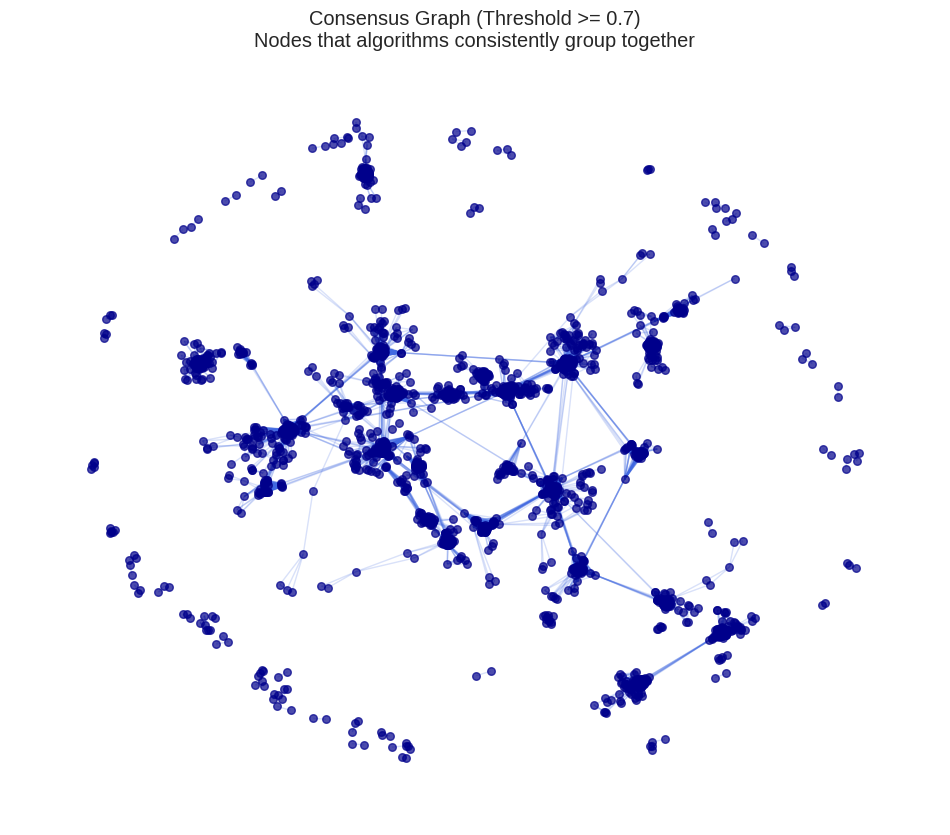

Identified 98643 reliable relationships.


In [ ]:
df_gold_relationships_G_S03, network_gold_relationships_G_S03 = extract_consensus_and_plot(df_community_analisis_G_S03, threshold=0.7)

**Umbral analysis in concensus graph**

In [ ]:
df_gold_relationships_G_S03

,Node_A,Node_B,Consensus_Strength
0,A/100/ILE,A/109/ALA,0.8
1,A/100/ILE,A/112/ALA,0.8
2,A/100/ILE,A/113/LYS,0.8
3,A/100/ILE,A/120/PRO,0.8
4,A/100/ILE,A/169/ASP,0.8
...,...,...,...
98638,D/95/MET,D/99/GLY,0.8
98639,D/96/LYS,D/99/GLY,0.8
98640,D/97/ARG,D/98/MET,0.8
98641,D/97/ARG,D/99/GLY,0.8


In [ ]:
df_multi_threshold_G_S03 = generate_multi_threshold_consensus_csv(df_community_analisis_G_S03, thresholds=[1.0, 0.9, 0.8, 0.7, 0.6])

Multi-threshold consensus file generated: multi_threshold_consensus.csv


In [ ]:
df_multi_threshold_G_S03

,Node,threshold_1.0,threshold_0.9,threshold_0.8,threshold_0.7,threshold_0.6
0,A/100/ILE,1,1,1,1,1
1,A/101/GLU,2,2,1,1,1
2,A/1021/HOH,3,3,2,2,2
3,A/102/ALA,4,4,1,1,1
4,A/103/ILE,5,5,1,1,1
...,...,...,...,...,...,...
2914,D/979/HOH,1091,1091,208,208,187
2915,D/97/ARG,1238,1238,1,1,1
2916,D/98/MET,564,564,1,1,1
2917,D/995/HOH,1239,1239,245,245,220


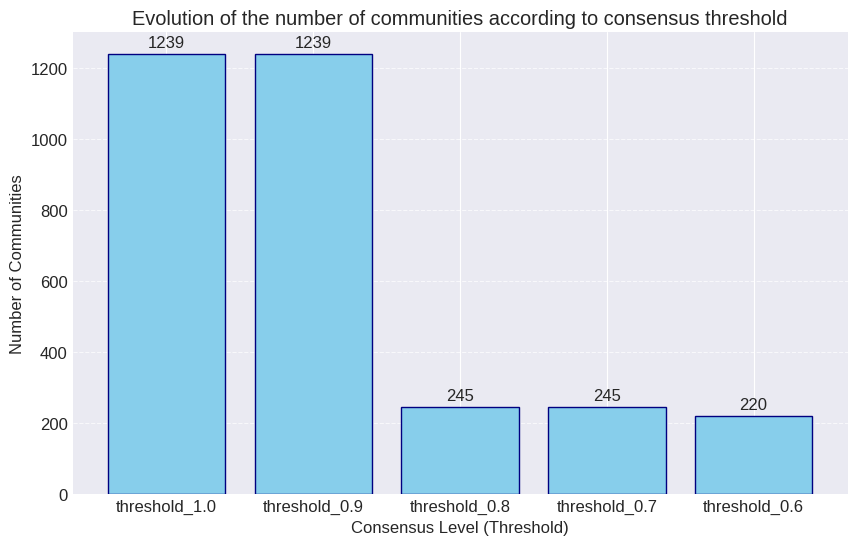

In [ ]:
plot_unit_count(df_multi_threshold_G_S03)

In [ ]:
#Execute Sankey passing that specific dataframe
generate_filtered_sankey(df_multi_threshold_G_S03, min_nodes=5)

In [ ]:
# (Opcional) Establecer el nodo como el índice para realizar búsquedas rápidas
# df_analisis.set_index('Nodo', inplace=True)

# 3. Mostrar las primeras filas y un resumen rápido
print("Vista previa del análisis comparativo:")
print(df_community_analisis_G_S03.head())

print("\nConteo de comunidades por cada método:")
print(df_community_analisis_G_S03.nunique())

Vista previa del análisis comparativo:
         Node  Infomap  Modularity  Label_Propagation  Girvan_Newman  \
0   A/100/ILE        1           7                  1              1   
1   A/101/GLU        1          24                  2              1   
2  A/1021/HOH      153          73                  3              2   
3   A/102/ALA        1           9                  4              1   
4   A/103/ILE        1           9                  5              1   

   K_Clique_3  
0           0  
1           0  
2           0  
3           0  
4           0  

Conteo de comunidades por cada método:
Node                 2919
Infomap               223
Modularity            244
Label_Propagation     931
Girvan_Newman         221
K_Clique_3            186
dtype: int64


 #### e) Structural analysis


=== ANALYSIS OF INTERACTION TYPES ===
Types of interaction found (columna: interaction):
interaction
HBOND        2559
VDW          2532
PIPISTACK     145
IONIC          89
PICATION       44
METAL_ION       9
PIHBOND         4
Name: count, dtype: int64


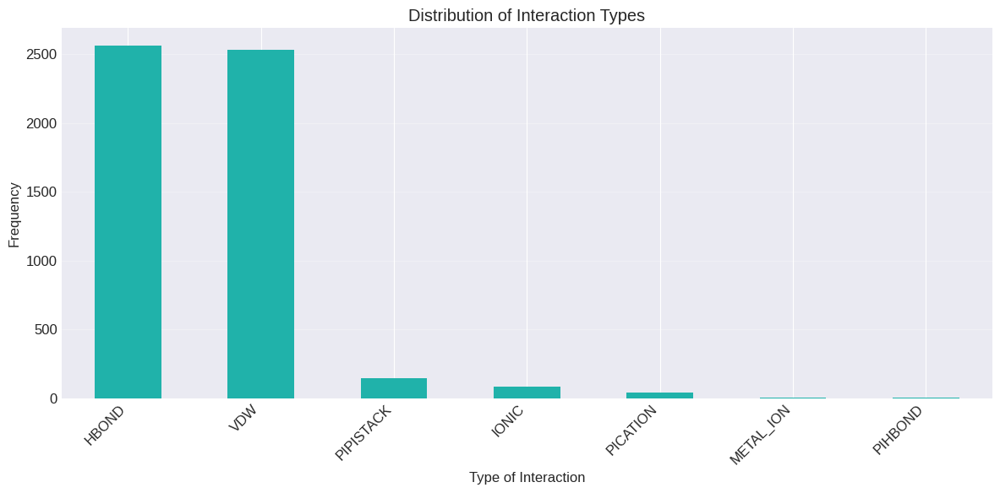

In [ ]:
# Analizar tipos de interacción
distribucion_interacciones_S03 = analizar_tipos_interaccion(df_edges_S03, G_S03)

In [ ]:
df_bio_G03 = calculate_complete_properties('./6EE1-R.pdb')

⚠️ Note: PROPKA could not process some elements: module 'propka.lib' has no attribute 'load_molecule'


In [ ]:
df_bio_G03

,id,Type,SASA,Adjusted_pKa,Hydrophobicity
0,A/12/THR,Amino Acid,63.14,N/A,-0.7
1,A/13/PRO,Amino Acid,91.78,N/A,-1.6
2,A/14/PHE,Amino Acid,52.52,N/A,2.8
3,A/15/GLU,Amino Acid,88.19,N/A,-3.5
4,A/16/GLN,Amino Acid,131.38,N/A,-3.5
...,...,...,...,...,...
2914,D/766/ALA,Amino Acid,57.69,N/A,1.8
2915,D/801/ACO,Ligand,114.10,N/A,NaN
2916,D/802/MG,Ion,1.23,N/A,NaN
2917,D/979/HOH,Water,4.29,N/A,NaN


In [ ]:
df_Structural_properties_G_S03 = analyze_allosteric_properties('./6EE1-R.pdb')

In [ ]:
df_Structural_properties_G_S03

,id,SASA,B-Factor,Hydrophobicity,Packing_Density
0,A/12/THR,63.14,85.49,-0.7,4
1,A/13/PRO,91.78,78.48,-1.6,6
2,A/14/PHE,52.52,62.66,2.8,6
3,A/15/GLU,88.19,81.35,-3.5,7
4,A/16/GLN,131.38,82.54,-3.5,8
...,...,...,...,...,...
2903,D/764/LYS,77.30,75.20,-3.9,8
2904,D/765/GLU,135.74,83.08,-3.5,5
2905,D/766/ALA,57.69,77.54,1.8,5
2906,D/801/ACO,114.10,74.26,NaN,3


**Betweeness versus B-factor**

📊 Spearman Correlation: -0.341 (p-value: 3.039e-80)

🚀 Candidates for Rigid Allosteric Centers (High Betweenness / Low B-Factor):
           Node  Betweenness_Val  B-Factor
1460  C/108/TRP         0.076425     40.45
2554  D/457/TRP         0.073372     51.37
485   A/559/GLU         0.067874     60.10
1902  C/527/GLN         0.067508     45.98
481   A/555/MET         0.065885     53.77


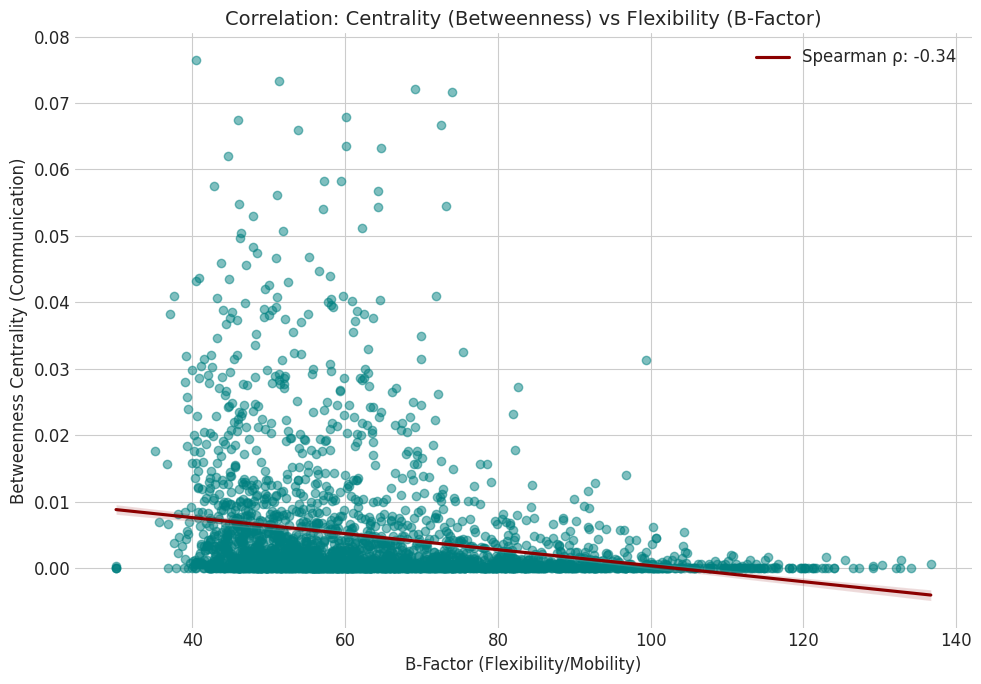

In [ ]:
df_Betweeness_B_factor_G_S03 = plot_network_structure_correlation(df_full_G_S03, df_Structural_properties_G_S03)

**Discussion:** That **Spearman ($ρ=−0.341$)** value with such an extremely low p-value ($3×10^{−80}$) is irrefutable statistical proof of an organizing principle in the protein: **communication is shielded from flexibility.**

Here is the scientific interpretation:

- **The Meaning of the Negative Correlation**

A negative correlation of -0.341 indicates that information flow (Betweenness) **actively avoids disordered regions**. The protein does not trust "loose wires" to send signals. Instead, it uses a **"high-fidelity backbone."**

* Being rigid (low B-Factor), these residues do not waste energy on random thermal vibrations, allowing a conformational change at one site to be transmitted almost entirely to a distant point.

- **Analysis of the Candidates (The Information "Relays")**

It is very revealing that the top two candidates are **Tryptophans (TRP)**:

* **C/108/TRP and D/457/TRP:** Tryptophan is the most bulky and rigid amino acid. Due to its large aromatic ring, it often acts as a structural "anchor." Their having the highest Betweenness suggests they function as **pivot nodes**. Their rigidity ensures that when the protein moves, these residues act as solid levers that shift entire domains.
* **A/559/GLU and C/527/GLN:** Glutamate and glutamine are polar residues. Their appearance here suggests that rigid communication is not only hydrophobic (in the core), but also involves very stable **hydrogen bond networks** that act as "welds" between different parts of the protein.

**Hypothesis:** If these residues are located between the active site and a ligand-binding site, they form the "railway track" connecting both centers.

#### Percolation analysis

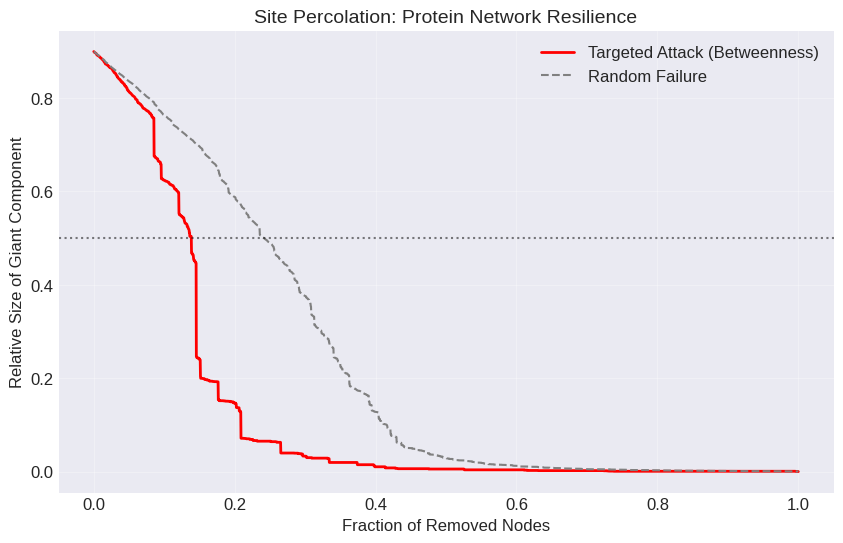

In [ ]:
df_percolacion_G_S03 = site_percolation_analysis(G_S03)

In [ ]:
df_percolacion_G_S03

,Fraction,Targeted_Size,Random_Size
0,0.000000,0.899281,0.899281
1,0.000343,0.898938,0.898938
2,0.000685,0.897910,0.898595
3,0.001028,0.897568,0.898253
4,0.001370,0.897225,0.897979
...,...,...,...
2915,0.998630,0.000343,0.000343
2916,0.998972,0.000343,0.000343
2917,0.999315,0.000343,0.000343
2918,0.999657,0.000343,0.000343
